In [56]:
import tensorflow as tf
import matplotlib.image as img
#%matplotlib inline
import numpy as np
from collections import defaultdict
import collections
from shutil import copy
from shutil import copytree, rmtree
import tensorflow.keras.backend as K
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt
import numpy as np
import os
import random
import tensorflow as tf
tf.compat.v1.disable_eager_execution()
import tensorflow.keras.backend as K
from tensorflow.keras import regularizers
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten
from tensorflow.keras.layers import Convolution2D, MaxPooling2D, ZeroPadding2D, GlobalAveragePooling2D, AveragePooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ModelCheckpoint, CSVLogger
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.regularizers import l2
from tensorflow import keras
from tensorflow.keras import models
import cv2

In [57]:
# Load the saved model trained with 3 classes
K.clear_session()
print("Loading the model..")
model = load_model('best_model.hdf5',compile = False)
print("Done!")

Loading the model..
Done!


In [58]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   864         ['input_1[0][0]']                
                                32)                                                               
                                                                                                  
 batch_normalization (BatchNorm  (None, None, None,   96         ['conv2d[0][0]']                 
 alization)                     32)                                                           

In [59]:
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    x = np.clip(x, 0, 255).astype('uint8')
    return x


In [60]:
def generate_pattern(layer_name, filter_index, size=150):
    # Build a loss function that maximizes the activation
    # of the nth filter of the layer considered.
    layer_output = model.get_layer(layer_name).output
    loss = K.mean(layer_output[:, :, :, filter_index])

    # Compute the gradient of the input picture wrt this loss
    grads = K.gradients(loss, model.input)[0]

    # Normalization trick: we normalize the gradient
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

    # This function returns the loss and grads given the input picture
    iterate = K.function([model.input], [loss, grads])
    
    # We start from a gray image with some noise
    input_img_data = np.random.random((1, size, size, 3)) * 20 + 128.

    # Run gradient ascent for 40 steps
    step = 1.
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step
        
    img = input_img_data[0]
    return deprocess_image(img)

In [61]:
def get_activations(img, model_activations):
    img = image.load_img(img, target_size=(299, 299))
    img = image.img_to_array(img)                    
    img = np.expand_dims(img, axis=0)         
    img /= 255. 
    plt.imshow(img[0])
    plt.show()
    return model_activations.predict(img)
    

In [62]:
def show_activations(activations, layer_names):
    
    images_per_row = 16

    # Now let's display our feature maps
    for layer_name, layer_activation in zip(layer_names, activations):
        # This is the number of features in the feature map
        n_features = layer_activation.shape[-1]

        # The feature map has shape (1, size, size, n_features)
        size = layer_activation.shape[1]

        # We will tile the activation channels in this matrix
        n_cols = n_features // images_per_row
        display_grid = np.zeros((size * n_cols, images_per_row * size))

        # We'll tile each filter into this big horizontal grid
        for col in range(n_cols):
            for row in range(images_per_row):
                channel_image = layer_activation[0,
                                                 :, :,
                                                 col * images_per_row + row]
                # Post-process the feature to make it visually palatable
                channel_image -= channel_image.mean()
                channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
                channel_image = np.clip(channel_image, 0, 255).astype('uint8')
                display_grid[col * size : (col + 1) * size,
                             row * size : (row + 1) * size] = channel_image

        # Display the grid
        scale = 1. / size
        plt.figure(figsize=(scale * display_grid.shape[1],
                            scale * display_grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.imshow(display_grid, aspect='auto', cmap='viridis')

    plt.show()



In [63]:
len(model.layers)

315

In [64]:
# We start with index 1 instead of 0, as input layer is at index 0
layers = [layer.output for layer in model.layers[1:11]]
# We now initialize a model which takes an input and outputs the above chosen layers
activations_output = models.Model(inputs=model.input, outputs=layers)

In [65]:
layers

[<tf.Tensor 'conv2d/Conv2D:0' shape=(None, None, None, 32) dtype=float32>,
 <tf.Tensor 'batch_normalization/cond/Identity:0' shape=(None, None, None, 32) dtype=float32>,
 <tf.Tensor 'activation/Relu:0' shape=(None, None, None, 32) dtype=float32>,
 <tf.Tensor 'conv2d_1/Conv2D:0' shape=(None, None, None, 32) dtype=float32>,
 <tf.Tensor 'batch_normalization_1/cond/Identity:0' shape=(None, None, None, 32) dtype=float32>,
 <tf.Tensor 'activation_1/Relu:0' shape=(None, None, None, 32) dtype=float32>,
 <tf.Tensor 'conv2d_2/Conv2D:0' shape=(None, None, None, 64) dtype=float32>,
 <tf.Tensor 'batch_normalization_2/cond/Identity:0' shape=(None, None, None, 64) dtype=float32>,
 <tf.Tensor 'activation_2/Relu:0' shape=(None, None, None, 64) dtype=float32>,
 <tf.Tensor 'max_pooling2d/MaxPool:0' shape=(None, None, None, 64) dtype=float32>]

In [66]:
layer_names = []
for layer in model.layers[1:11]:
    layer_names.append(layer.name)
print(layer_names)

['conv2d', 'batch_normalization', 'activation', 'conv2d_1', 'batch_normalization_1', 'activation_1', 'conv2d_2', 'batch_normalization_2', 'activation_2', 'max_pooling2d']


In [67]:
#Download Example Images

#!wget -O samosa.jpg http://veggiefoodrecipes.com/wp-content/uploads/2016/05/lentil-samosa-recipe-01.jpg
#!wget -O applepie.jpg https://acleanbake.com/wp-content/uploads/2017/10/Paleo-Apple-Pie-with-Crumb-Topping-gluten-free-grain-free-dairy-free-15.jpg

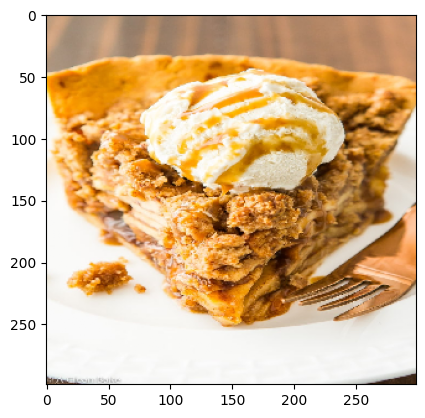

In [68]:
food = 'applepie.jpg'
activations = get_activations(food,activations_output)

C:\Users\tpgus\AppData\Local\Temp\ipykernel_6484\2562928467.py:25: RuntimeWarning: invalid value encountered in divide
  channel_image /= channel_image.std()
C:\Users\tpgus\AppData\Local\Temp\ipykernel_6484\2562928467.py:28: RuntimeWarning: invalid value encountered in cast
  channel_image = np.clip(channel_image, 0, 255).astype('uint8')


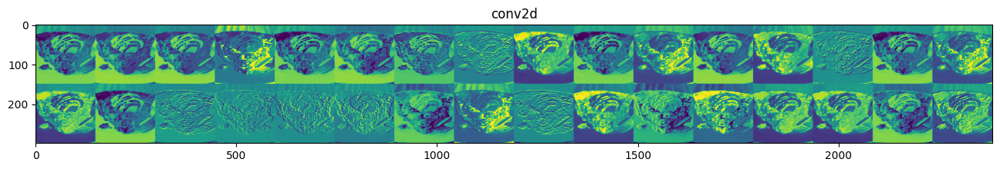

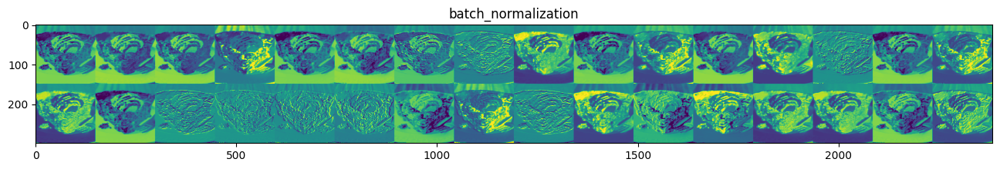

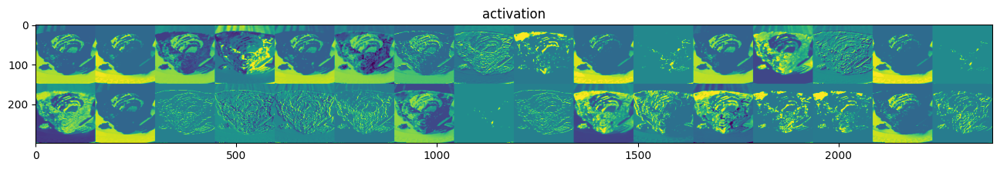

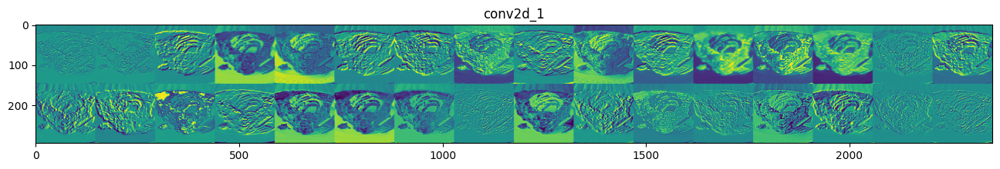

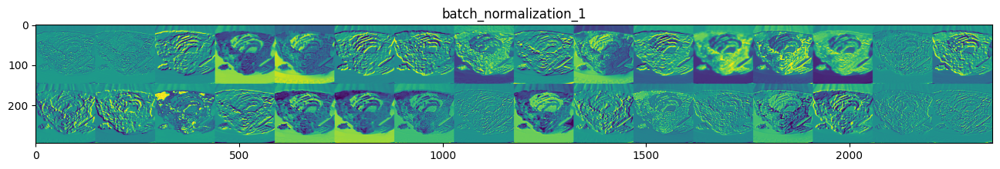

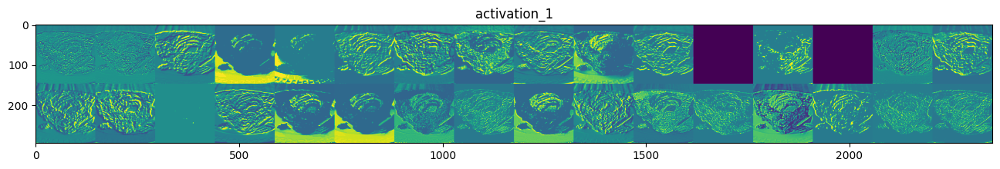

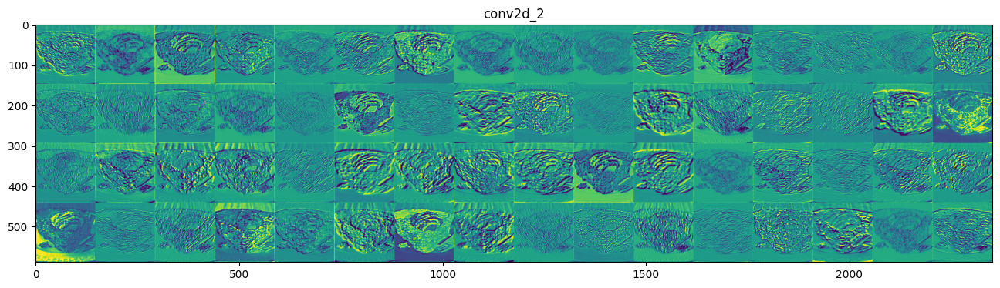

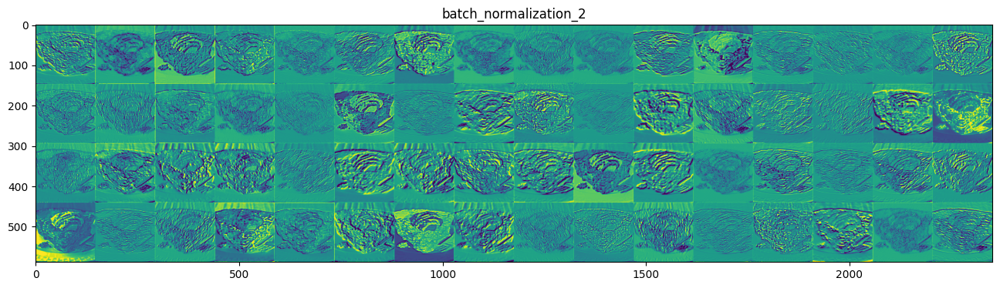

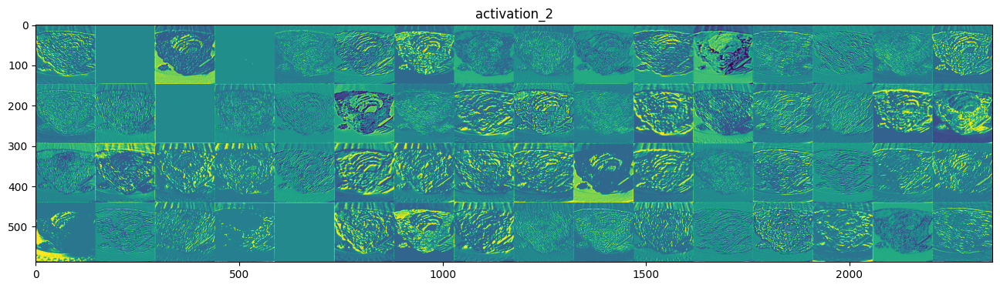

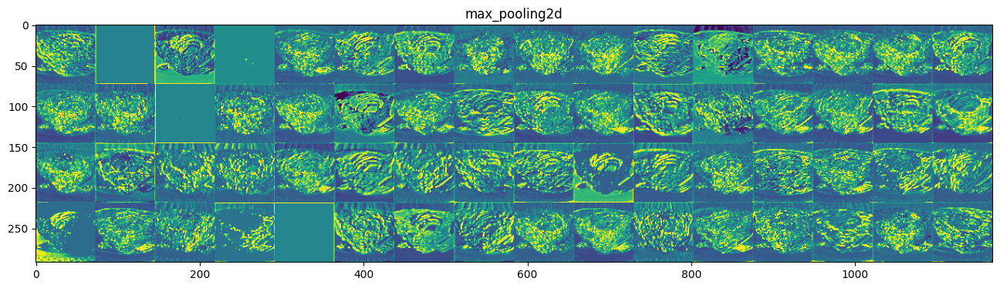

In [69]:
show_activations(activations, layer_names)

In [70]:
food = 'samosa.jpg'
activations = get_activations(food,activations_output)

FileNotFoundError: [Errno 2] No such file or directory: 'samosa.jpg'

C:\Users\tpgus\AppData\Local\Temp\ipykernel_6484\2562928467.py:25: RuntimeWarning: invalid value encountered in divide
  channel_image /= channel_image.std()
C:\Users\tpgus\AppData\Local\Temp\ipykernel_6484\2562928467.py:28: RuntimeWarning: invalid value encountered in cast
  channel_image = np.clip(channel_image, 0, 255).astype('uint8')


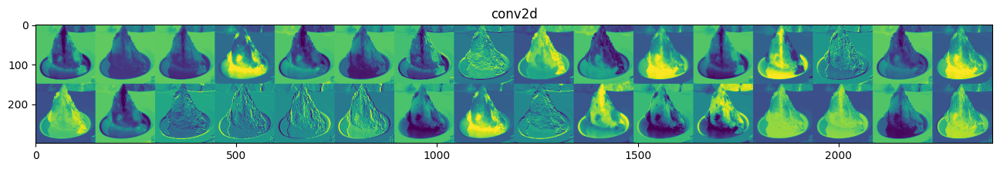

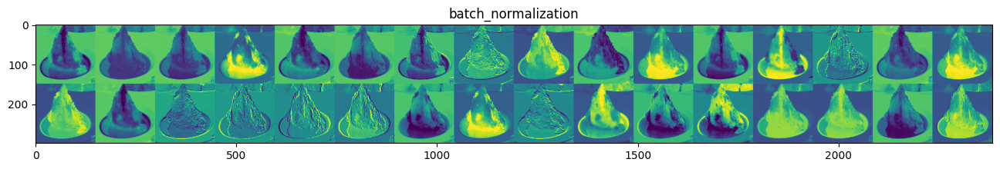

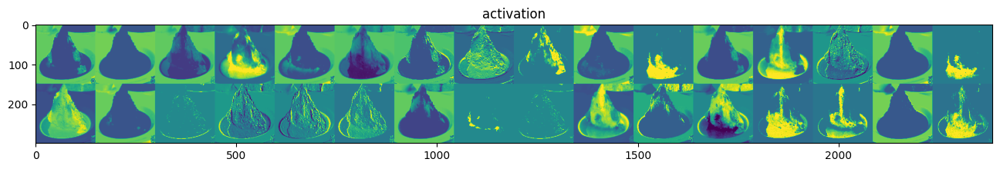

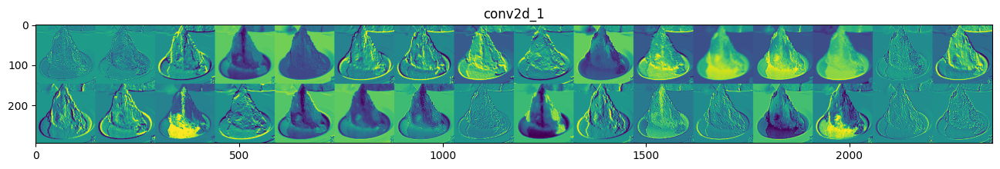

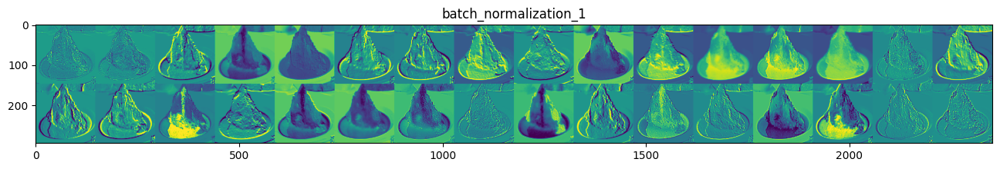

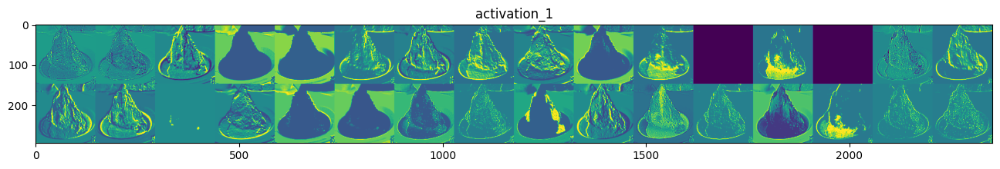

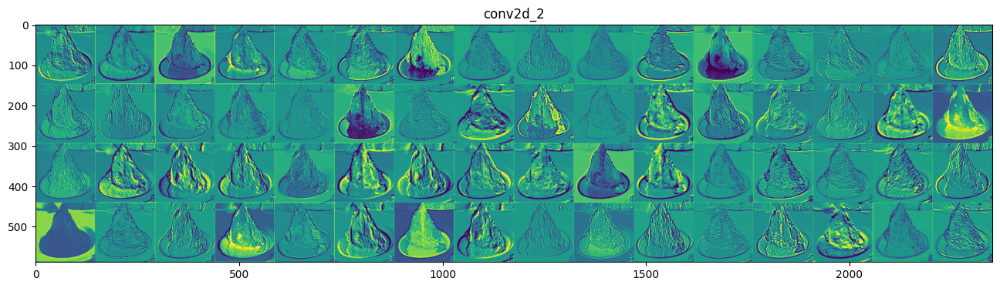

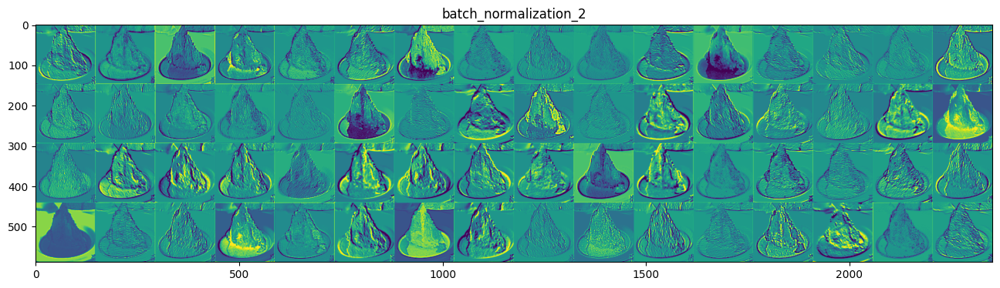

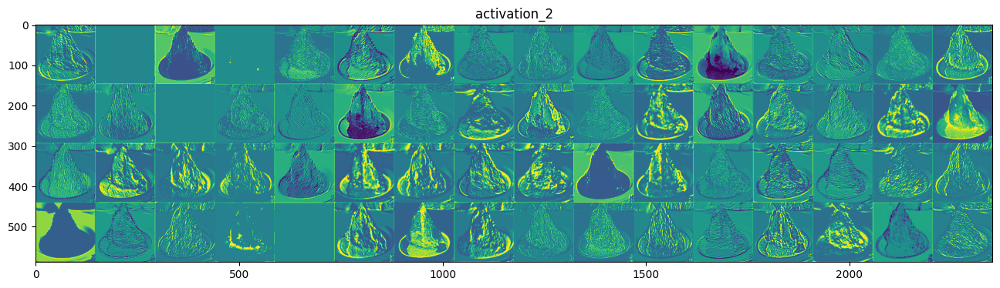

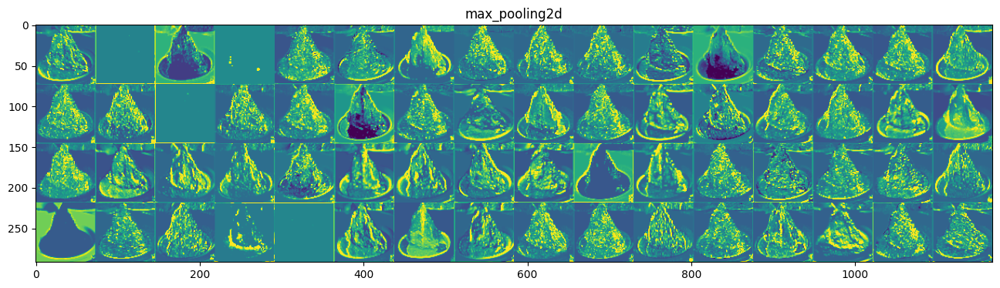

In [ ]:
show_activations(activations, layer_names)

In [ ]:
# Get the index of activation_1 layer which has sparse activations
ind = layer_names.index('activation_1')
sparse_activation = activations[ind]
a = sparse_activation[0, :, :, 13]
a

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]], dtype=float32)

In [ ]:
all (np.isnan(a[j][k])  for j in range(a.shape[0]) for k in range(a.shape[1]))

True

In [ ]:
# Get the index of batch_normalization_1 layer which has sparse activations
ind = layer_names.index('batch_normalization_1')
sparse_activation = activations[ind]
b = sparse_activation[0, :, :, 13]
b

array([[ 61.404625,  61.404625,  61.404625, ..., 156.25258 , 152.21649 ,
        150.19846 ],
       [ 61.404625,  61.404625,  61.404625, ..., 154.23454 , 152.21649 ,
        152.21649 ],
       [ 61.404625,  61.404625,  61.404625, ..., 154.23454 , 152.21649 ,
        152.21649 ],
       ...,
       [ 63.42267 ,  65.440704,  67.458755, ...,  83.60309 ,  91.67525 ,
         69.47679 ],
       [ 51.314415,  57.368546,  61.404625, ...,  85.621124,  99.74742 ,
         79.567   ],
       [ 35.170082,  41.224213,  47.278336, ..., 105.801544,  97.72938 ,
         65.440704]], dtype=float32)

Text(0.5, 1.0, 'Conv2d_3')

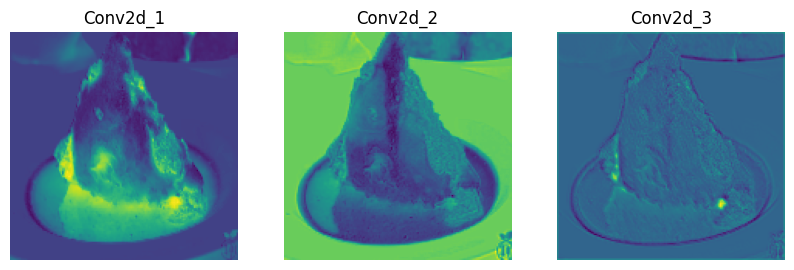

In [ ]:
first_convlayer_activation = activations[0]
second_convlayer_activation = activations[3]
third_convlayer_activation = activations[6]
f,ax = plt.subplots(1,3, figsize=(10,10))
ax[0].imshow(first_convlayer_activation[0, :, :, 3], cmap='viridis')
ax[0].axis('OFF')
ax[0].set_title('Conv2d_1')
ax[1].imshow(second_convlayer_activation[0, :, :, 3], cmap='viridis')
ax[1].axis('OFF')
ax[1].set_title('Conv2d_2')
ax[2].imshow(third_convlayer_activation[0, :, :, 3], cmap='viridis')
ax[2].axis('OFF')
ax[2].set_title('Conv2d_3')


In [ ]:
def get_attribution(food):
    img = image.load_img(food, target_size=(299, 299))
    img = image.img_to_array(img) 
    img /= 255. 
    f,ax = plt.subplots(1,3, figsize=(15,15))
    ax[0].imshow(img)
    
    img = np.expand_dims(img, axis=0) 
    
    preds = model.predict(img)
    class_id = np.argmax(preds[0])
    ax[0].set_title("Input Image")
    class_output = model.output[:, class_id]
    last_conv_layer = model.get_layer("mixed10")
    
    grads = K.gradients(class_output, last_conv_layer.output)[0]
    pooled_grads = K.mean(grads, axis=(0, 1, 2))
    iterate = K.function([model.input], [pooled_grads, last_conv_layer.output[0]])
    pooled_grads_value, conv_layer_output_value = iterate([img])
    for i in range(2048):
        conv_layer_output_value[:, :, i] *= pooled_grads_value[i]
    
    heatmap = np.mean(conv_layer_output_value, axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    ax[1].imshow(heatmap)
    ax[1].set_title("Heat map")
    
    
    act_img = cv2.imread(food)
    heatmap = cv2.resize(heatmap, (act_img.shape[1], act_img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed = cv2.addWeighted(act_img, 0.6, heatmap, 0.4, 0)
    cv2.imwrite('classactivation.png', superimposed)
    img_act = image.load_img('classactivation.png', target_size=(299, 299))
    ax[2].imshow(img_act)
    ax[2].set_title("Class Activation")
    plt.show()
    return preds

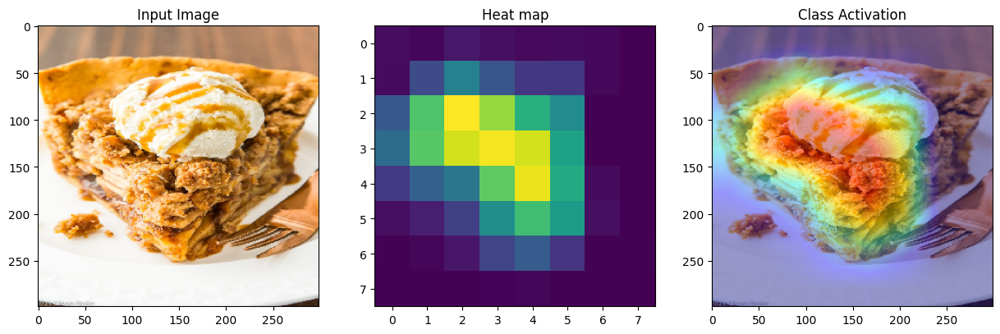

Here are softmax predictions.. [[6.7207044e-01 2.8061466e-05 1.0949805e-01 1.7360705e-06 1.3898098e-05
  1.0883621e-06 2.4793472e-04 1.0979877e-04 1.2969287e-01 4.8729602e-05
  9.0297937e-07 1.2123674e-05 3.9539754e-04 4.2929761e-07 3.7511953e-03
  2.0637574e-06 1.9436866e-05 4.0861854e-04 1.5221098e-04 3.3019205e-05
  1.6760006e-05 3.2331925e-04 6.9750467e-04 2.0183081e-05 4.6839701e-05
  3.0721696e-06 2.4466122e-05 5.2659278e-05 3.9544830e-05 6.6552580e-05
  2.8566448e-05 8.9314992e-05 5.8517253e-05 4.8852885e-06 1.7280585e-05
  1.8569078e-06 7.3942651e-06 9.5416708e-06 1.8223263e-06 4.4203840e-05
  5.5659893e-06 7.5927623e-05 1.0843424e-04 5.1903839e-06 1.9223972e-04
  3.9012841e-04 4.6974528e-05 1.3245442e-05 3.7196287e-07 1.2371674e-05
  9.6647846e-06 4.5369616e-06 1.4463979e-05 2.8530374e-05 1.3736783e-05
  2.5686115e-05 1.5234189e-05 1.1010738e-04 7.4146733e-02 1.1791891e-03
  2.9358705e-05 2.2188584e-05 5.1680638e-04 5.6997029e-05 3.3150463e-05
  1.0274070e-05 6.8062960e-05 1.9

In [ ]:
pred = get_attribution('applepie.jpg')
print("Here are softmax predictions..",pred)

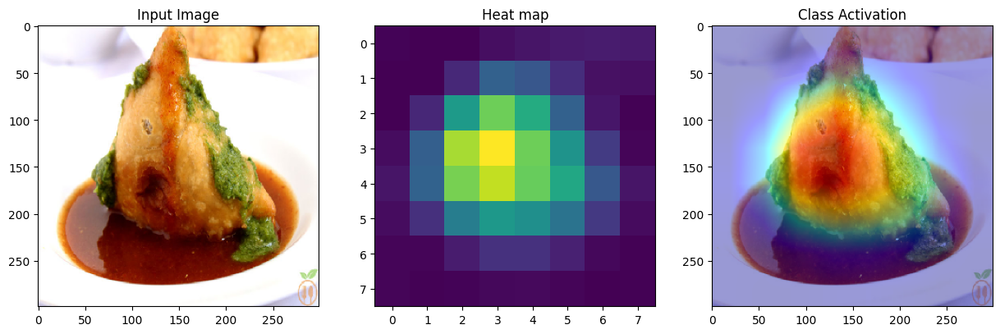

Here are softmax predictions.. [[3.48901754e-04 1.02612294e-05 2.99454114e-04 8.41492056e-06
  3.21303378e-05 2.64743562e-06 1.43211655e-04 3.39598864e-06
  1.61086471e-04 7.97759931e-05 1.31674142e-05 9.82978690e-06
  2.46978270e-05 1.74442703e-05 4.83602616e-06 5.32118975e-05
  2.71249464e-05 4.17798947e-06 1.65767124e-04 5.78707441e-05
  1.21503690e-04 1.48048017e-07 5.03957472e-06 7.74155069e-06
  1.64568683e-05 1.03367643e-06 3.07720220e-05 7.52135384e-05
  3.14900581e-06 1.72057753e-05 1.39203054e-04 9.82035181e-06
  8.74049321e-04 1.54935449e-04 2.74227386e-05 3.77045944e-04
  2.21163664e-05 2.28612294e-06 7.49580431e-05 8.33215108e-06
  2.15913151e-05 2.58105574e-05 3.24758621e-05 7.35094500e-06
  1.59271476e-05 3.32254349e-05 8.69635551e-05 1.95692537e-05
  3.64871175e-06 3.08939925e-05 9.46597902e-06 2.23089373e-04
  1.13376591e-03 1.33691719e-05 1.04905121e-05 1.15063540e-05
  7.93543677e-06 4.46667909e-05 8.71978264e-05 1.20725699e-05
  2.96310900e-05 3.07879636e-05 1.62043

In [ ]:
pred = get_attribution('samosa.jpg')
print("Here are softmax predictions..",pred)

In [ ]:
# Download Mixed Exmaple Images

#!wget -O piepizza.jpg https://raw.githubusercontent.com/theimgclist/PracticeGround/master/Food101/piepizza.jpg
#!wget -O piepizzas.png https://raw.githubusercontent.com/theimgclist/PracticeGround/master/Food101/piepizzas.png
#!wget -O pizzapie.jpg https://raw.githubusercontent.com/theimgclist/PracticeGround/master/Food101/pizzapie.jpg
#!wget -O pizzapies.png https://raw.githubusercontent.com/theimgclist/PracticeGround/master/Food101/pizzapies.png    

--2023-01-16 00:07:38--  https://raw.githubusercontent.com/theimgclist/PracticeGround/master/Food101/piepizza.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 70232 (69K) [image/jpeg]
Saving to: 'piepizza.jpg'

     0K .......... .......... .......... .......... .......... 72% 6.16M 0s
    50K .......... ........                                   100%  116M=0.008s

2023-01-16 00:07:39 (8.28 MB/s) - 'piepizza.jpg' saved [70232/70232]

--2023-01-16 00:07:39--  https://raw.githubusercontent.com/theimgclist/PracticeGround/master/Food101/piepizzas.png
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443..

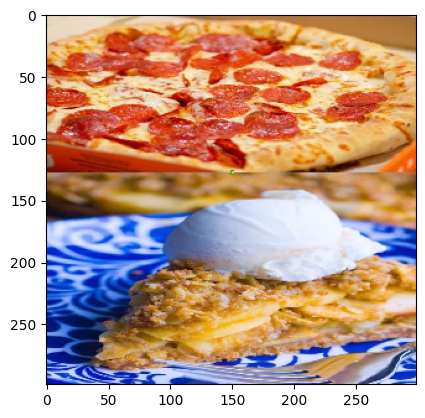

In [ ]:
food = 'piepizza.jpg'
activations = get_activations(food,activations_output)

C:\Users\tpgus\AppData\Local\Temp\ipykernel_6484\2562928467.py:25: RuntimeWarning: invalid value encountered in divide
  channel_image /= channel_image.std()
C:\Users\tpgus\AppData\Local\Temp\ipykernel_6484\2562928467.py:28: RuntimeWarning: invalid value encountered in cast
  channel_image = np.clip(channel_image, 0, 255).astype('uint8')


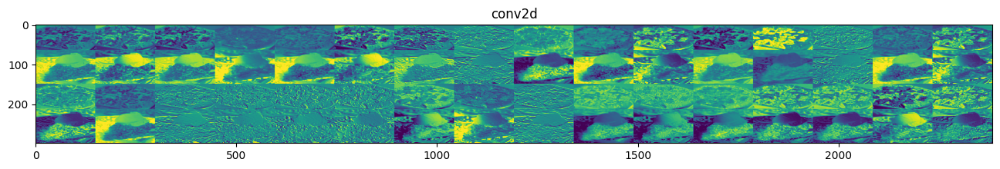

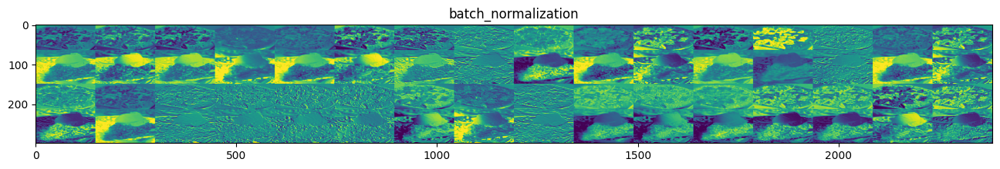

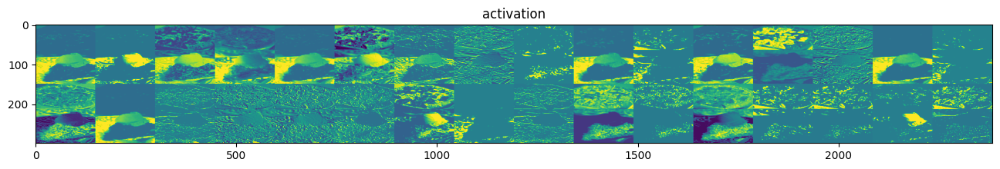

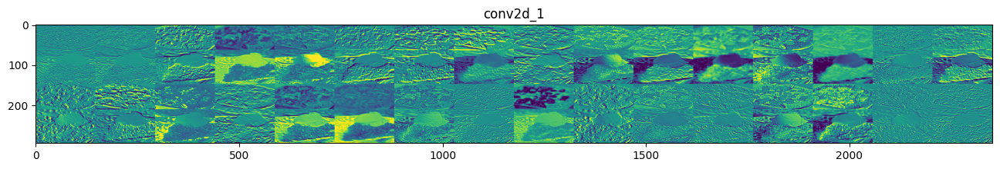

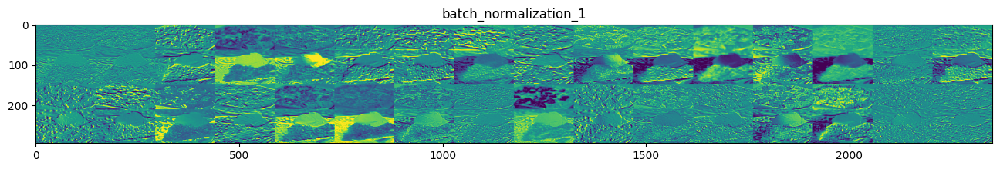

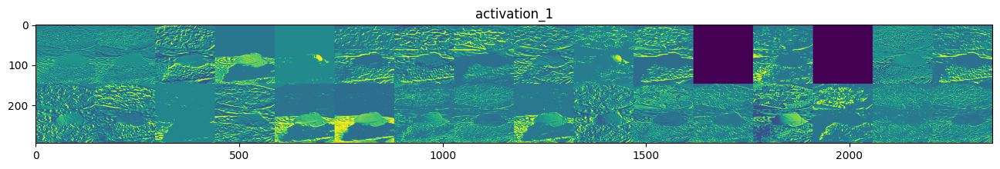

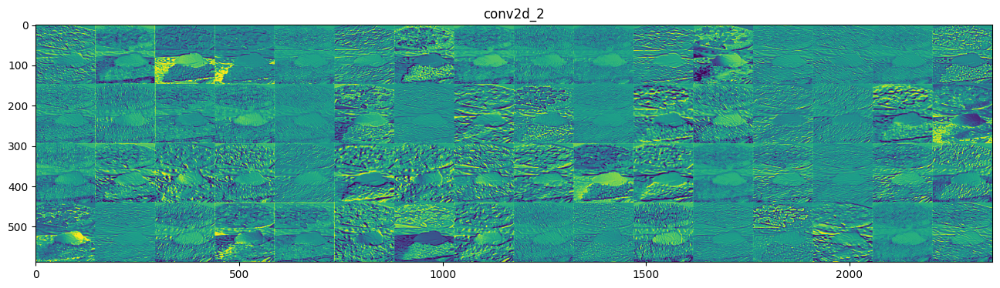

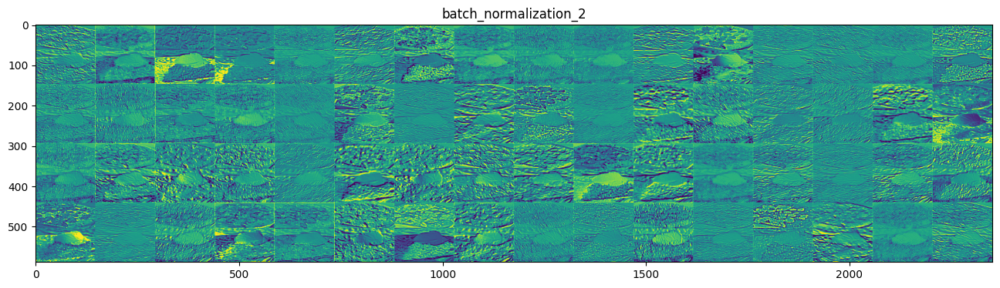

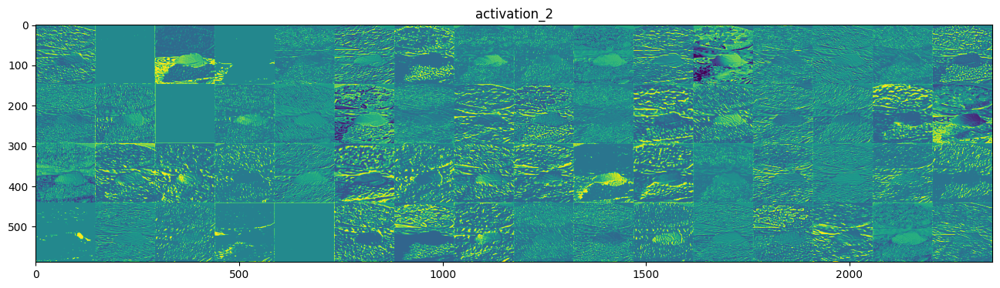

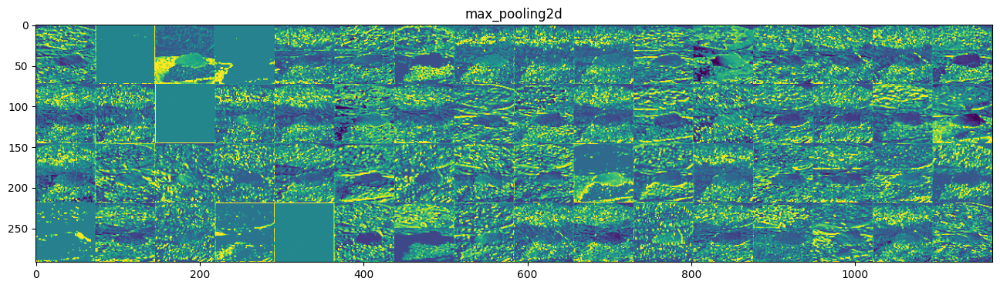

In [ ]:
show_activations(activations, layer_names)

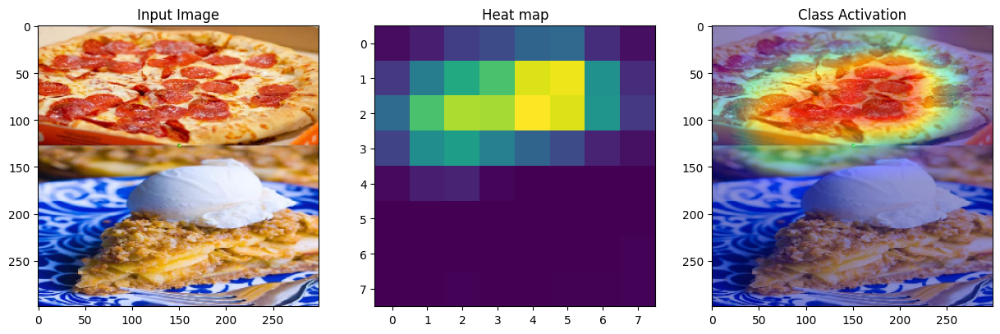

Here are softmax predictions.. [[1.86080579e-03 7.61605042e-05 2.13079635e-04 3.27229878e-04
  1.32249770e-04 1.03275115e-05 1.02709222e-04 1.14523664e-05
  9.44951898e-04 2.14380361e-05 6.88412227e-04 1.23994923e-05
  2.50037381e-04 2.21335958e-05 1.50821405e-03 2.40858772e-05
  1.20988734e-04 5.79242269e-03 8.32718652e-05 2.66023824e-04
  9.60831894e-05 4.35684924e-04 3.31725751e-04 3.51054186e-05
  9.59780518e-05 1.72629298e-05 3.62162086e-06 3.08856863e-04
  2.53441285e-05 1.20026933e-04 1.11902946e-05 1.82918870e-04
  3.96613294e-04 4.29125976e-06 5.77299033e-06 1.76650399e-04
  3.42958992e-05 8.64851791e-06 4.09845643e-06 7.93141953e-05
  1.68222850e-05 1.21937650e-04 1.49055311e-04 2.68065924e-05
  6.76587588e-05 2.57399137e-04 5.33549406e-04 2.81088927e-04
  5.29054569e-06 3.00500578e-05 5.85659700e-06 1.92596485e-06
  1.04560233e-04 1.26654959e-05 1.81583673e-04 1.05586034e-04
  1.11064628e-05 4.64767108e-05 3.26084730e-04 1.35557819e-03
  6.74172916e-05 2.37208835e-04 2.64073

In [ ]:
pred = get_attribution('piepizza.jpg')
print("Here are softmax predictions..",pred)

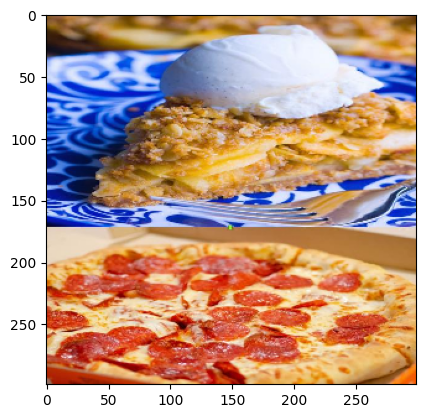

In [ ]:
food = 'pizzapie.jpg'
activations = get_activations(food,activations_output)

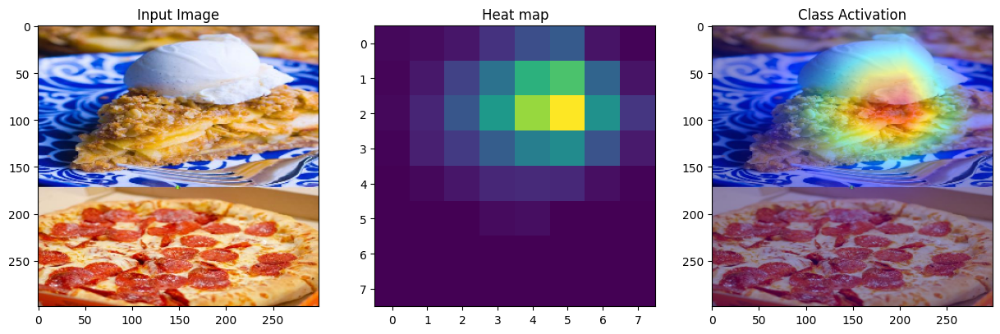

Here are softmax predictions.. [[6.39885664e-01 1.88871418e-04 1.28899828e-01 6.60657533e-05
  1.28182626e-04 1.11100890e-05 3.08278576e-03 5.26016338e-05
  4.60756086e-02 4.21094446e-05 2.52860860e-04 1.05793988e-04
  3.82933649e-03 7.11634493e-06 6.75245095e-03 2.89434120e-05
  3.26894369e-04 2.98885885e-03 1.57227681e-04 2.40562469e-04
  2.24652991e-04 7.45317026e-04 5.76694787e-04 1.70667394e-04
  2.06512690e-04 2.36918258e-05 2.89092604e-05 2.66449701e-04
  8.56828410e-05 2.52459780e-04 6.92047543e-05 1.70642347e-03
  2.05107476e-03 4.53744215e-05 3.47498535e-05 7.45479774e-05
  2.50772373e-05 1.56062670e-05 5.10906211e-05 2.37454369e-04
  1.38411691e-04 1.54995127e-04 2.63299304e-03 6.31022194e-05
  1.78839837e-04 9.72348207e-04 2.50846776e-03 1.19472353e-03
  3.38101972e-06 1.47549261e-04 2.70422643e-05 6.39458267e-06
  7.94310588e-04 4.88403093e-05 8.69262221e-05 2.10767626e-04
  2.34771669e-05 1.20097611e-04 9.48016718e-03 9.41441022e-03
  6.13441298e-05 2.99606618e-04 4.53445

In [ ]:
pred = get_attribution('pizzapie.jpg')
print("Here are softmax predictions..",pred)

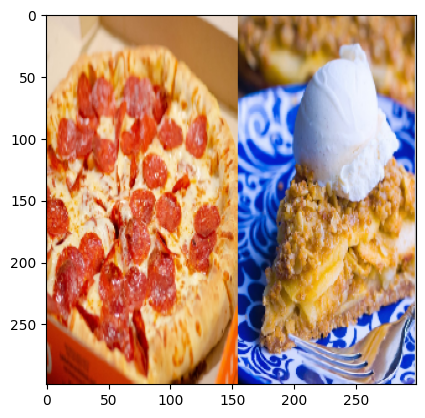

In [ ]:
food = 'pizzapies.png'
activations = get_activations(food,activations_output)

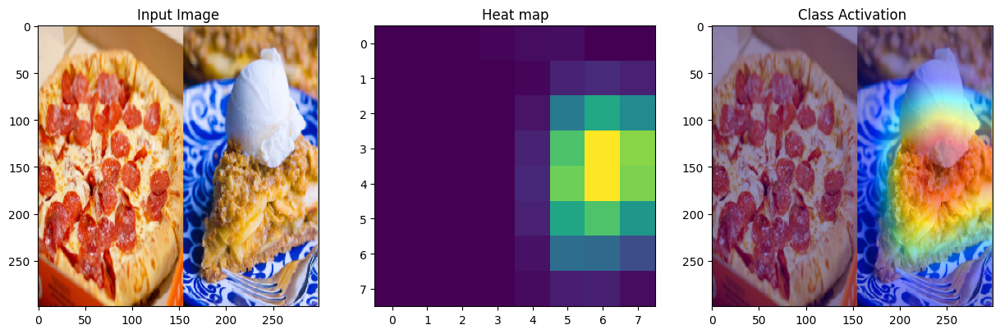

Here are softmax predictions.. [[5.95260262e-01 1.38906194e-04 3.60446349e-02 1.04493534e-04
  8.10836355e-05 1.86701902e-06 1.53396104e-03 6.49981303e-05
  2.58100405e-02 1.78041286e-04 3.90984205e-04 9.40702448e-05
  3.94604122e-03 9.05542947e-06 4.08610422e-03 1.80185598e-05
  9.26568682e-05 2.75798771e-03 3.46084416e-04 6.54189847e-04
  1.02802893e-04 1.57462768e-04 1.05653002e-04 6.03270237e-05
  1.55650967e-04 4.83897857e-05 4.21204350e-05 2.49837496e-04
  1.44315680e-04 1.25529827e-04 7.77082678e-05 3.25206725e-04
  1.05892937e-03 2.37142194e-05 5.69788826e-05 6.41054430e-05
  3.76889475e-05 9.14138218e-06 5.30613106e-05 4.58507639e-05
  5.03592782e-05 1.98606722e-04 2.37421668e-03 2.73330625e-05
  2.56941566e-04 1.95477638e-04 5.29140141e-03 1.36747386e-03
  2.41696171e-06 1.53985675e-04 4.92332510e-05 1.07066899e-05
  4.74095170e-04 5.16315486e-05 7.20472963e-05 5.08445315e-04
  7.77693567e-05 2.07817255e-04 1.95130939e-03 2.89736055e-02
  6.50518923e-05 1.05909805e-03 3.33173

In [ ]:
pred = get_attribution('pizzapies.png')
print("Here are softmax predictions..",pred)

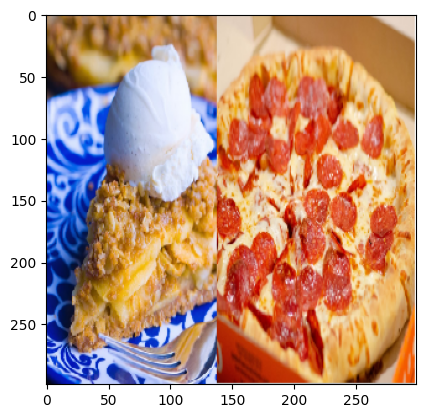

In [ ]:
food = 'piepizzas.png'
activations = get_activations(food,activations_output)

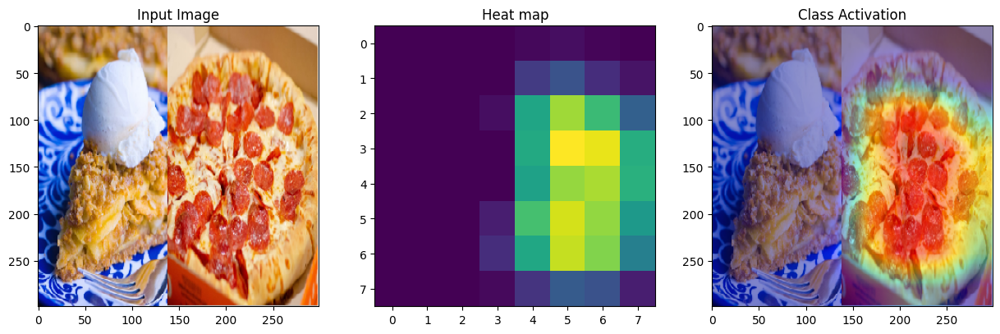

Here are softmax predictions.. [[1.3870821e-02 8.1148377e-05 9.3045272e-04 3.3808051e-04 1.1889797e-04
  5.8828159e-06 2.8434055e-04 4.6334946e-05 3.9440421e-03 1.0483329e-04
  4.9378281e-04 1.3359074e-04 1.3540320e-03 2.6326959e-05 2.1940223e-03
  2.2526054e-05 8.1593957e-05 1.0348331e-03 1.8588995e-04 1.0021873e-03
  1.0239984e-04 1.7220610e-04 9.1663082e-05 3.5851819e-05 1.4666590e-04
  1.8652951e-05 4.1790288e-05 3.3057440e-04 8.2398845e-05 1.2714659e-04
  5.2412364e-05 8.4725347e-05 6.2035007e-04 1.5754451e-05 6.1939230e-05
  1.6303119e-04 7.9427329e-05 4.4461736e-05 5.4243519e-05 1.6958586e-05
  2.7426715e-05 8.2931292e-05 2.0350381e-03 4.5088920e-05 1.1206990e-04
  1.5699220e-04 3.7122543e-03 2.6353186e-03 3.8829562e-06 7.2609662e-05
  3.5693454e-05 2.2611997e-05 2.8564717e-04 2.0924630e-05 6.0927163e-05
  1.7059765e-04 2.8351007e-04 2.2968226e-04 6.5290264e-04 1.6853547e-02
  4.5852415e-05 6.7096850e-04 3.7343153e-03 7.5651013e-05 4.1719049e-05
  6.1323088e-05 2.1480988e-03 8.1

In [ ]:
pred = get_attribution('piepizzas.png')
print("Here are softmax predictions..",pred)